# Машинное обучение, ВМК МГУ

# Практическое задание 1. Обучение без учителя.

## Общая информация
Дата выдачи: 22.02.2024

Мягкий дедлайн: 07.03.2024 23:59 MSK

Жёсткий дедлайн: 14.03.2024 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-1-Username.ipynb

Username — ваша фамилия на латинице

## О задании



В этом задании вам предлагается поработать с различными методами кластеризации и посмотреть их работу на различных данных

In [11]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

## Часть 1. Тематическое моделирование текстов.

В этом задании мы сравним разные алгоритмы кластеризации для задачи тематического моделирования.

**Задание 1.1 (1 балл).** Для начала реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Здесь необходимо использовать вариацию с ненормированным лапласианом.

In [12]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        L = np.diag(X.sum(axis=1)) - X
        eigenvalues, eigenvectors = np.linalg.eigh(L)
        return eigenvectors[:, : self.n_components]

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [ ]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


**Задание 1.2 (0.5 балла)** Теперь приступим к применению разных алгоритмов кластеризации для одной из самых популярных задач обучения без учителя: задачи тематического моделирования текстов.

Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. То есть, фактически, перед вами стоит задача кластеризации текстов с тем лишь дополнением что требется не только разбить тексты на группы, но и выделить ключевые слова, определяющие каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [13]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1289,politics,394.txt,Economy focus for election battle,Britain's economic future will be at the hear...
1872,tech,049.txt,Domain system scam fear,A system to make it easier to create website ...
1044,politics,149.txt,Blair returns from peace mission,Prime Minister Tony Blair has arrived back fr...
654,entertainment,145.txt,Sir Paul rocks Super Bowl crowds,Sir Paul McCartney wowed fans with a live min...
134,business,135.txt,Feta cheese battle reaches court,A row over whether only Greece should be allo...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [14]:
!pip install spacy
!python -m spacy download en_core_web_sm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 24.4 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [15]:
import re
import string
import spacy


nlp = spacy.load("en_core_web_sm")


def combine(data):
    data['text'] = data['title'] + data['content']
    return data.drop(columns=['title', 'content'])


def set_letters_only(data):
    data['text'] = data['text'].apply(lambda text: re.compile(r'-').sub(' ', text))
    data['text'] = data['text'].apply(lambda text: text.translate(str.maketrans('', '', string.punctuation)))
    data['text'] = data['text'].apply(lambda text: text.translate(str.maketrans('', '', string.digits)))
    data['text'] = data['text'].apply(lambda text: re.compile(r' {2,}').sub(' ', text))
    data['text'] = data['text'].str.lower().str.strip()


def lemmatize_no_stopwords(text):
    doc = nlp(text)
    lemmatized_text = ' '.join([token.lemma_ for token in doc if token.lemma_.lower() not in nlp.Defaults.stop_words and token.is_alpha])
    return lemmatized_text.split()


def lemmatize(data):
    data['text'] = data['text'].apply(lemmatize_no_stopwords)

In [16]:
data = combine(data)
set_letters_only(data)
lemmatize(data)

In [17]:
data.sample(5)

,category,filename,text
1900,tech,077.txt,"[rich, picking, hi, tech, thief, virus, trojan..."
357,business,358.txt,"[deutsche, attack, yukos, case, german, invest..."
1975,tech,152.txt,"[new, year, texting, break, record, mobile, ph..."
829,entertainment,320.txt,"[johnny, cash, manager, holiff, die, manager, ..."
21,business,022.txt,"[sluggish, economy, hit, german, job, number, ..."


Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [18]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)

    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

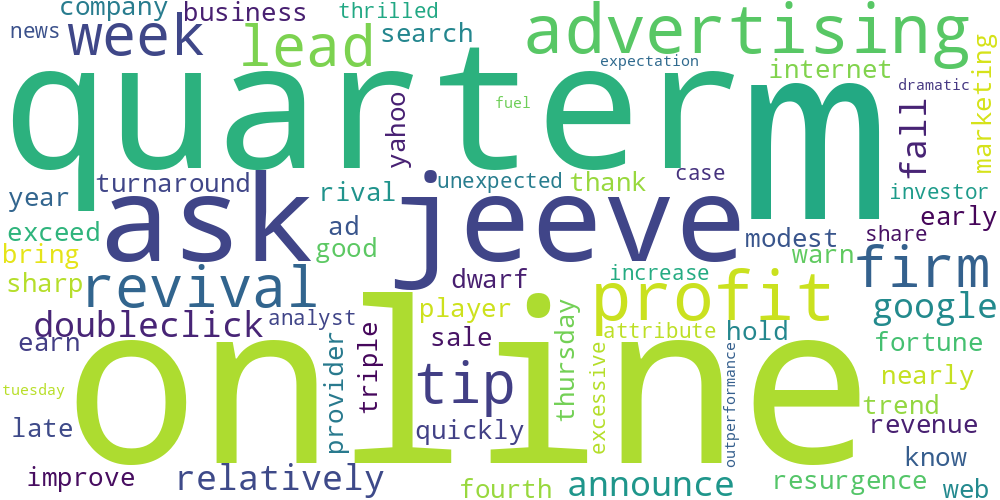

In [ ]:
draw_wordcloud(data.text[10])

**Задание 1.3 (1 балл).** Начнем с простого: обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. (?) Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:**
Темы в некоторой степени интерпретируемы. Если смотреть только на облака тегов и пытаться озаглавить каждый кластер, то получится что-то вроде этого:
1. Rugby in england
2. Mobile technologies
3. Market and companies
4. Sport wins
5. Oskar awards
6. Microsoft security software
7. Game clubs
8. Government elections

In [19]:
from sklearn.feature_extraction.text import TfidfVectorizer

def kmean_with_tf_idf(data, n_clusters=8, random_state=0, min_df=3, **kwargs):
    kmeans = KMeans(n_clusters=n_clusters, random_state=random_state, n_init='auto', **kwargs)

    tfidf = TfidfVectorizer(tokenizer=(lambda s: s), stop_words='english', lowercase=False, min_df=min_df)
    fitted_tfidf = tfidf.fit(data.text.tolist())
    tfidf_matrix = fitted_tfidf.transform(data.text.tolist())

    fitted_kmeans = kmeans.fit(tfidf_matrix)

    labels = fitted_kmeans.predict(tfidf_matrix)

    return labels, fitted_tfidf, fitted_kmeans

In [ ]:
labels, fitted_tfidf, fitted_kmeans = kmean_with_tf_idf(data)

/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:409: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['b', 'c', 'd', 'e', 'f', 'g', 'h', 'k', 'l', 'm', 'n', 'o', 'p', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y'] not in stop_words.
  warnings.warn(


In [ ]:
labeled_docs = dict()

for i in range(8):
    labeled_docs[i] = data.text[labels == i]

In [ ]:
labeled_docs[0]

942     [student, fee, factor, play, rise, record, num...
1314    [osullivan, run, world, sonia, osullivan, indi...
1328    [verdict, delay, greek, sprinter, greek, athle...
1329    [kenteris, clear, kosta, kenteris, lawyer, dop...
1335    [greek, pair, attend, drug, hear, greek, sprin...
                              ...                        
1729    [darcy, injury, add, ireland, woe, gordon, dar...
1730    [odriscoll, scotland, game, ireland, captain, ...
1731    [tindall, aim, earn, lion, spot, bath, england...
1732    [oconnor, aim, grab, opportunity, johnny, ocon...
1851    [piero, rugby, perspective, bbc, sport, unveil...
Name: text, Length: 160, dtype: object

In [ ]:
clusters = dict()

for i in range(8):
    clusters[i] = []
    for elem in labeled_docs[i].tolist():
        clusters[i] += elem

In [ ]:
data.category.unique()

array(['business', 'entertainment', 'politics', 'sport', 'tech'],
      dtype=object)

In [20]:
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

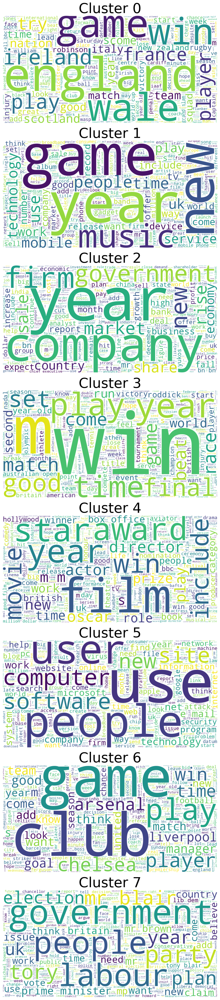

In [ ]:
fig, ax = plt.subplots(8, 1, figsize=(10, 5*8))

for i in range(8):
    ax[i].imshow(draw_wordcloud(clusters[i]))
    ax[i].axis('off')
    ax[i].set_title(f'Cluster {i}', fontsize=40)

plt.tight_layout()
plt.show()

**Задание 1.4 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на несколько слов с наибольшими числовыми значениями. (?) Соответствуют ли полученные слова облакам тегов из прошлого задания?

**Ответ:** Судя по полученным центрам кластеров, они, в целом, соответствуют своим облакам тегов, но лучше показывают тематику кластеров.

In [ ]:
for i in range(8):
    cluster_center = fitted_kmeans.cluster_centers_[i]
    words = fitted_tfidf.get_feature_names_out()[np.argsort(cluster_center)[::-1][:8]]
    print(f'Cluster {i} center words: {words}')


Cluster 0 center words: ['england' 'rugby' 'ireland' 'wale' 'game' 'coach' 'nation' 'robinson']
Cluster 1 center words: ['music' 'mobile' 'game' 'phone' 'tv' 'people' 'band' 'digital']
Cluster 2 center words: ['bn' 'company' 'year' 'firm' 'bank' 'growth' 'economy' 'rise']
Cluster 3 center words: ['win' 'm' 'final' 'champion' 'world' 'seed' 'open' 'olympic']
Cluster 4 center words: ['film' 'award' 'star' 'oscar' 'good' 'actor' 'm' 'win']
Cluster 5 center words: ['software' 'user' 'use' 'computer' 'site' 'virus' 'mail' 'e']
Cluster 6 center words: ['club' 'chelsea' 'game' 'arsenal' 'play' 'league' 'player' 'goal']
Cluster 7 center words: ['mr' 'labour' 'election' 'blair' 'party' 'tory' 'government' 'minister']


**Задание 1.5 (можно получить 1.5, 1 или 2.5 баллов)** Попробуем усовершенствовать метод. Реализуйте в приведенном ниже шаблоне ядерный K-means(1.5 баллов) или эллипсоидный метод(1 балл) (можно оба сразу, тогда баллы сложатся). И попробуйте применить его для решаемой задачи. (?)Насколько существенно отличаются  центры кластеров и облака тегов от таковых для предыдущих методов?

Для метода kernel kmeans мы получаем отличное сочетание облаков кластеров и центроидов. Гораздо лучшее, чем в предыдущем эксперименте. Однако эллиптический метод показывает себя не очень хорошо. Это может быть связано с тем, что идёт подсчёт матрицы ковариации по всем данным, а не по отдельным кластерам. Если пересчитывать матрицу ковариации для каждого кластера, то время работы алгоритма существенно увеличивается.

In [21]:
from sklearn.metrics.pairwise import euclidean_distances
from time import time


class KernelKMeans:
    def __init__(self, n_clusters, iters, kernel='poly'):
        """
        KMeans Class constructor.

        Args:
        n_clusters (int) : Number of clusters used for partitioning.
        iters (int) : Number of iterations until the algorithm stops.

        """
        self.kernels_available = ['poly', 'rbf']

        self.n_clusters = n_clusters
        self.iters = iters
        self.centroids_ = None
        self.labels_ = None
        self.kernel_matrix = None
        self.kernel = kernel


    def initialize_clusters(self, X, n_clusters):
        """
        Initialize centroids.

        Args:
        X (ndarray): Dataset samples
        n_clusters (int): Number of clusters

        Returns:
        centroids (ndarray): Initial position of centroids
        """
        if X.shape[0] < n_clusters:
            return np.array([])

        self.labels_ = np.arange(n_clusters)
        if X.shape[0] > n_clusters:
            self.labels_ = np.append(self.labels_, np.random.randint(low=0, high=n_clusters, size=X.shape[0] - n_clusters))
        self.centroids_ = np.array([np.mean(X[self.labels_ == i], axis=0) for i in range(n_clusters)])

        if self.kernel == 'poly':
            self.kernel_matrix = (np.ones_like(X) + (X.dot(X.T).toarray()) / X.shape[1]) ** 3
        elif self.kernel == 'rbf':
            self.kernel_matrix = np.exp(euclidean_distances(X, X) ** 2 / (-X.shape[1]))
        else:
            self.kernel_matrix = X.dot(X.T)

        return self.centroids_


    def get_dist(self, cluster_label):
        cluster_size = self.labels_[self.labels_ == cluster_label].shape[0]
        cluster_inds = np.where(self.labels_ == cluster_label)[0]
        result = (self.kernel_matrix.diagonal()
                  - 2 * (1 / cluster_size) * np.sum(self.kernel_matrix[cluster_inds], axis=0)
                  + np.tile((1 / (cluster_size ** 2)) * np.sum(self.kernel_matrix[cluster_inds][:, cluster_inds]), self.labels_.shape[0]))

        return result


    def get_argmin(self, X):
        self.distances = np.zeros((X.shape[0], self.n_clusters))
        for i in range(self.n_clusters):
            self.distances[:, i] = self.get_dist(i)
        return np.argmin(self.distances, axis=1)


    def fit_predict(self, X):
        """
        Implementation of the kernel KMeans algorithm.

        Args:
        X (ndarray): Dataset samples

        Returns:
        centroids (ndarray): Computed centroids
        labels (ndarray): Predicts for each sample in the dataset.
        """
        self.centroids_ = self.initialize_clusters(X, self.n_clusters)

        for i in range(self.iters):
            self.labels_ = self.get_argmin(X)

        self.centroids_ = np.array([np.asarray(np.mean(X[self.labels_ == i], axis=0)).tolist()[0] for i in range(self.n_clusters)])

        return self.centroids_, self.labels_

    def get_centroids(self):
        """
        Return the computed centroids
        """
        return self.centroids_


In [ ]:
kernel_kmeans = KernelKMeans(n_clusters=8, iters=300)

tfidf = TfidfVectorizer(tokenizer=(lambda s: s), stop_words='english', lowercase=False, min_df=0.005)
fitted_tfidf = tfidf.fit(data.text.tolist())
tfidf_matrix = fitted_tfidf.transform(data.text.tolist())

centroids, labels = kernel_kmeans.fit_predict(tfidf_matrix)

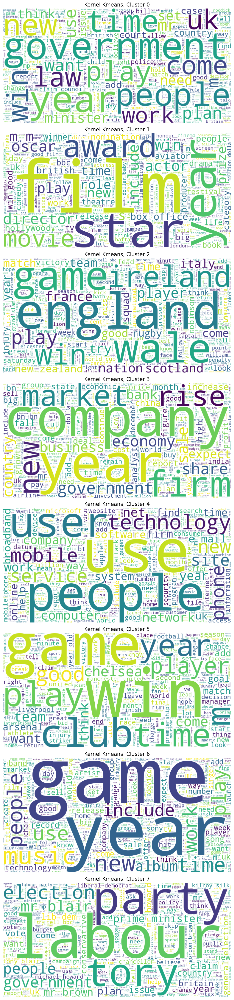

In [ ]:
labeled_docs = dict()

for i in range(8):
    labeled_docs[i] = data.text[labels == i]

clusters = dict()

for i in range(8):
    clusters[i] = []
    for elem in labeled_docs[i].tolist():
        clusters[i] += elem

fig, ax = plt.subplots(8, 1, figsize=(10, 5*8))

for i in range(8):
    ax[i].imshow(draw_wordcloud(clusters[i]))
    ax[i].axis('off')
    ax[i].set_title(f'Kernel Kmeans, Cluster {i}', fontsize=15)

plt.tight_layout()
plt.show()

In [ ]:
for i in range(8):
    cluster_center = centroids[i]
    words = fitted_tfidf.get_feature_names_out()[np.argsort(cluster_center)[::-1][:8]]
    print(f'Cluster {i} center words: {words}')


Cluster 0 center words: ['government' 'lord' 'mr' 'open' 'law' 'seed' 'minister' 'year']
Cluster 1 center words: ['film' 'award' 'star' 'oscar' 'actor' 'good' 'm' 'festival']
Cluster 2 center words: ['england' 'ireland' 'wale' 'rugby' 'game' 'france' 'nation' 'robinson']
Cluster 3 center words: ['bn' 'company' 'firm' 'market' 'bank' 'year' 'growth' 'rise']
Cluster 4 center words: ['mobile' 'phone' 'use' 'user' 'people' 'net' 'service' 'site']
Cluster 5 center words: ['club' 'm' 'win' 'game' 'chelsea' 'play' 'player' 'olympic']
Cluster 6 center words: ['music' 'game' 'band' 'album' 'year' 'tv' 'song' 'chart']
Cluster 7 center words: ['mr' 'election' 'labour' 'party' 'blair' 'tory' 'brown' 'howard']


In [22]:
from sklearn.metrics import pairwise_distances

class EllipticalClustering:
    def __init__(self, n_clusters, iters):
        """
        EllipticalClustering Class constructor.

        Args:
        n_clusters (int) : Number of clusters used for partitioning.
        iters (int) : Number of iterations until the algorithm stops.

        """
        self.n_clusters = n_clusters
        self.iters = iters
        self.centroids_ = None
        self.labels_ = None

    def initialize_clusters(self, X, n_clusters):
        """
        Initialize centroids.

        Args:
        X (ndarray): Dataset samples
        n_clusters (int): Number of clusters

        Returns:
        centroids (ndarray): Initial position of centroids
        """
        self.centroids_ = [X[np.random.randint(X.shape[0])]]

        for _ in range(1, n_clusters):
            distribution = np.min(euclidean_distances(X, self.centroids_) ** 2, axis=1)
            distribution /= np.sum(distribution)
            index = np.random.choice(np.arange(X.shape[0]), p=distribution)
            self.centroids_.append(X[index])

        self.centroids_ = np.array(self.centroids_)
        return self.centroids_

    def get_covariance_inv(self, X):
        return np.linalg.pinv(np.cov(X.T)).T

    def get_argmin(self, X):
        distances = pairwise_distances(X, self.centroids_, metric='mahalanobis', VI=self.covariance) ** 2
        return np.argmin(distances, axis=1)

    def calc_centroids(self, X, labels):
        return np.array([np.ravel(X[labels == i].mean(axis=0)) for i in range(self.n_clusters)])

    def fit_predict(self, X):
        """
        Implementation of the elliptical clustering algorithm.

        Args:
        X (ndarray): Dataset samples

        Returns:
        centroids (ndarray): Computed centroids
        labels (ndarray): Predicts for each sample in the dataset.
        """
        start = time()

        self.centroids_ = self.initialize_clusters(X, self.n_clusters)
        self.covariance = self.get_covariance_inv(X)

        labels_prev = None

        for i in range(self.iters):
            self.labels_ = self.get_argmin(X)
            self.centroids_ = self.calc_centroids(X, self.labels_)

            if labels_prev is not None and np.all(labels_prev == self.labels_):
                break

            labels_prev = self.labels_[:]

        print(f'Time: {time() - start}')

        return self.centroids_, self.labels_

    def get_centroids(self):
        """
        Return the computed centroids
        """
        return self.centroids_


In [ ]:
el_clusto = EllipticalClustering(n_clusters=8, iters=300)
tfidf = TfidfVectorizer(tokenizer=(lambda s: s), stop_words='english', lowercase=False, min_df=0.005)
fitted_tfidf = tfidf.fit(data.text.tolist())
tfidf_matrix = fitted_tfidf.transform(data.text.tolist())
print('tfidf matrix shape: ', tfidf_matrix.shape)
centroids, labels = el_clusto.fit_predict(tfidf_matrix.toarray())

tfidf matrix shape:  (2225, 3754)
Time: 605.3918569087982


In [ ]:
print('Уникальные кластеры: ', np.unique(labels))

Уникальные кластеры:  [0 1 2 3 4 5 6 7]


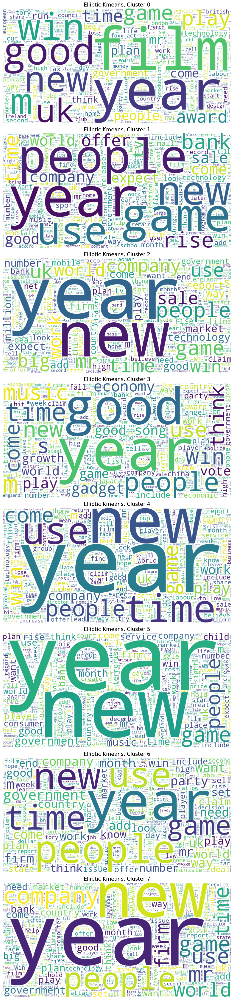

In [ ]:
labeled_docs = dict()

for i in range(8):
    labeled_docs[i] = data.text[labels == i]

clusters = dict()

for i in range(8):
    clusters[i] = []
    for elem in labeled_docs[i].tolist():
        clusters[i] += elem

fig, ax = plt.subplots(8, 1, figsize=(10, 5*8))

for i in range(8):
    ax[i].imshow(draw_wordcloud(clusters[i]))
    ax[i].axis('off')
    ax[i].set_title(f'Elliptic Kmeans, Cluster {i}', fontsize=15)

plt.tight_layout()
plt.show()

In [ ]:
for i in range(8):
    cluster_center = centroids[i]
    words = fitted_tfidf.get_feature_names_out()[np.argsort(cluster_center)[::-1][:8]]
    print(f'Cluster {i} center words: {words}')


Cluster 0 center words: ['film' 'good' 'mr' 'm' 'win' 'award' 'year' 'market']
Cluster 1 center words: ['bank' 'game' 'year' 'rate' 'sale' 'music' 'bn' 'people']
Cluster 2 center words: ['mr' 'year' 'bank' 'mobile' 'game' 'bn' 'new' 'sale']
Cluster 3 center words: ['year' 'good' 'growth' 'mr' 'economy' 'world' 'economic' 'm']
Cluster 4 center words: ['mr' 'year' 'm' 'film' 'win' 'people' 'game' 'good']
Cluster 5 center words: ['year' 'bank' 'game' 'music' 'mr' 'good' 'new' 'rise']
Cluster 6 center words: ['mr' 'year' 'new' 'bn' 'people' 'm' 'government' 'time']
Cluster 7 center words: ['mr' 'bank' 'company' 'year' 'm' 'bn' 'new' 'firm']


**Задание 1.6 (0.5 балла).** Теперь попробуем сравнить три разных алгоритма кластеризации. Получите три разбиения на кластеры с помощью алгоритмов K-Means(любого понравившегося), DBSCAN(можно взять готовый из sklearn) и спектральной кластеризации, реализованной вами выше. Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

In [ ]:
tfidf = TfidfVectorizer(tokenizer=(lambda s: s), lowercase=False, min_df=3)
fitted_tfidf = tfidf.fit(data.text.tolist())
tfidf_matrix = fitted_tfidf.transform(data.text.tolist())
print('tfidf matrix shape: ', tfidf_matrix.shape)

/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


tfidf matrix shape:  (2225, 9754)


In [23]:
from sklearn.cluster import DBSCAN
from sklearn.neighbors import kneighbors_graph

In [ ]:
kkmeans = KernelKMeans(n_clusters=5, iters=300)
spectral = GraphClustering(n_clusters=5)

In [ ]:
dbscan = DBSCAN(eps=1.0)

In [ ]:
_, kkmeans_labels = kkmeans.fit_predict(tfidf_matrix)

In [ ]:
W = kneighbors_graph(tfidf_matrix.toarray(), n_neighbors=60).toarray()
spectral_labels = spectral.fit_predict(W)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
dbscan_labels = dbscan.fit_predict(tfidf_matrix.toarray())

In [ ]:
print(np.unique(kkmeans_labels).shape)
print(np.unique(spectral_labels).shape)
print(np.unique(dbscan_labels).shape)

(5,)
(5,)
(33,)


In [ ]:
e=1.23
dbscan = DBSCAN(eps=e, min_samples=10)
dbscan_labels = dbscan.fit_predict(tfidf_matrix.toarray())
clusters = np.unique(dbscan_labels).shape[0]

print(clusters, e)

5 1.23


In [ ]:
dbscan = DBSCAN(eps=e, min_samples=10)
dbscan_labels = dbscan.fit_predict(tfidf_matrix.toarray())

In [ ]:
print(np.unique(kkmeans_labels).shape)
print(np.unique(spectral_labels).shape)
print(np.unique(dbscan_labels).shape)

(5,)
(5,)
(5,)


(?) Теперь постройте облака слов и снова проинтерпретируйте темы.

KernelKmeans

In [ ]:
clusters_n = 5

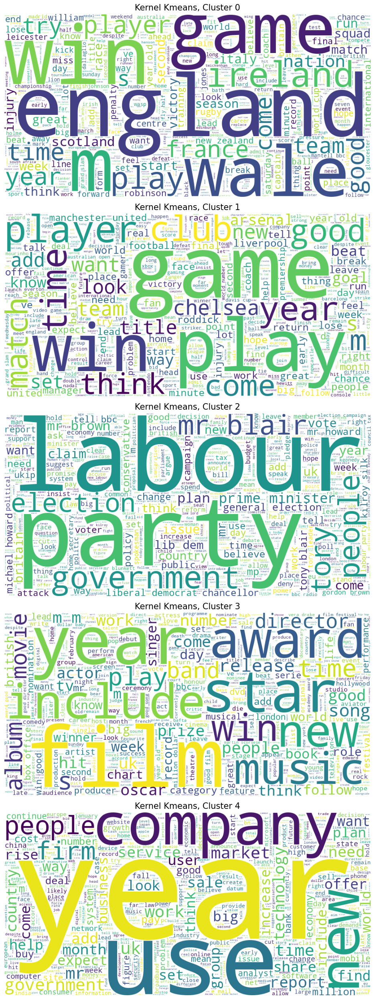

In [ ]:
labeled_docs = dict()

for i in range(clusters_n):
    labeled_docs[i] = data.text[kkmeans_labels == i]

clusters = dict()

for i in range(clusters_n):
    clusters[i] = []
    for elem in labeled_docs[i].tolist():
        clusters[i] += elem

fig, ax = plt.subplots(clusters_n, 1, figsize=(10, 5*clusters_n))

for i in range(clusters_n):
    ax[i].imshow(draw_wordcloud(clusters[i]))
    ax[i].axis('off')
    ax[i].set_title(f'Kernel Kmeans, Cluster {i}', fontsize=15)

plt.tight_layout()
plt.show()

Spectral Clustering

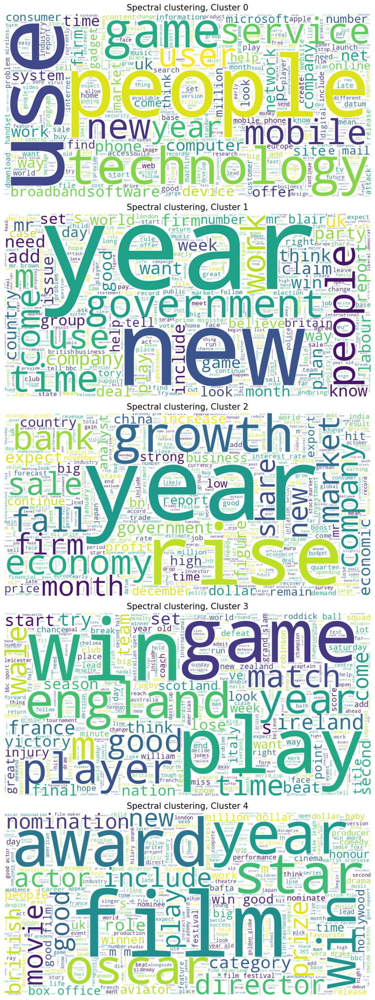

In [ ]:
labeled_docs = dict()

for i in range(clusters_n):
    labeled_docs[i] = data.text[spectral_labels == i]

clusters = dict()

for i in range(clusters_n):
    clusters[i] = []
    for elem in labeled_docs[i].tolist():
        clusters[i] += elem

fig, ax = plt.subplots(clusters_n, 1, figsize=(10, 5*clusters_n))

for i in range(clusters_n):
    ax[i].imshow(draw_wordcloud(clusters[i]))
    ax[i].axis('off')
    ax[i].set_title(f'Spectral clustering, Cluster {i}', fontsize=15)

plt.tight_layout()
plt.show()

DBSCAN

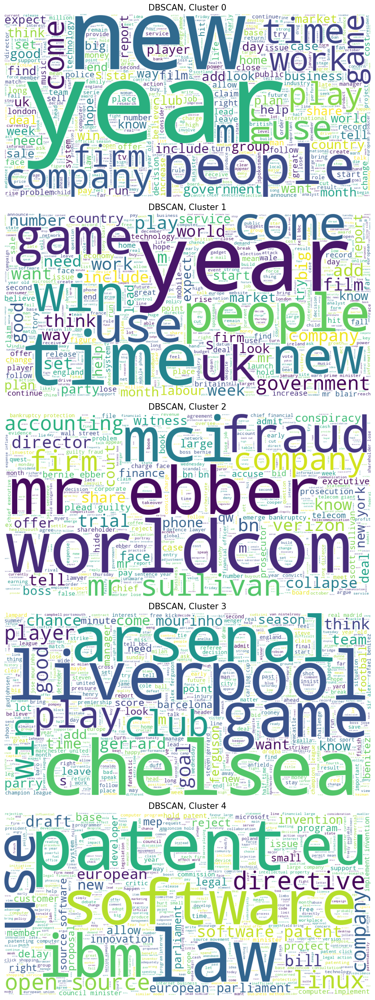

In [ ]:
labeled_docs = dict()
uniques = np.unique(dbscan_labels)

for i in range(clusters_n):
    labeled_docs[i] = data.text[dbscan_labels == uniques[i]]

clusters = dict()

for i in range(clusters_n):
    clusters[i] = []
    for elem in labeled_docs[i].tolist():
        clusters[i] += elem

fig, ax = plt.subplots(clusters_n, 1, figsize=(10, 5*clusters_n))

for i in range(clusters_n):
    ax[i].imshow(draw_wordcloud(clusters[i]))
    ax[i].axis('off')
    ax[i].set_title(f'DBSCAN, Cluster {i}', fontsize=15)

plt.tight_layout()
plt.show()

### Интерпретация тем

Kernel Kmeans:

1. Sport in England
2. Winning matches
3. Elections
4. Oscar awards
5. Companies economy on the market during a year

Spectral clustering:

1. Mobile technologies
2. New government
3. Market economy growth
4. Sport in England
5. Oscar awards

DBSCAN:

1. New year for firms
2. New time in UK
3. Mr Ebber and Mr Sullivan
4. Sport clubs
5. Software



**Задание 1.6 (1 балл).** Также, для анализа качества кластеризации иногда бывает полезно "посмотреть" накластеры. Обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [24]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

plt.rcParams.update({'font.size': 14})
sns.set_style('whitegrid')

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

plt.rcParams.update({'font.size': 14})
sns.set_style('whitegrid')

tsne = TSNE(n_components=2)
tfidf_tsne = tsne.fit_transform(tfidf_matrix.toarray())

df = pd.DataFrame(tfidf_tsne, columns=['x', 'y'])

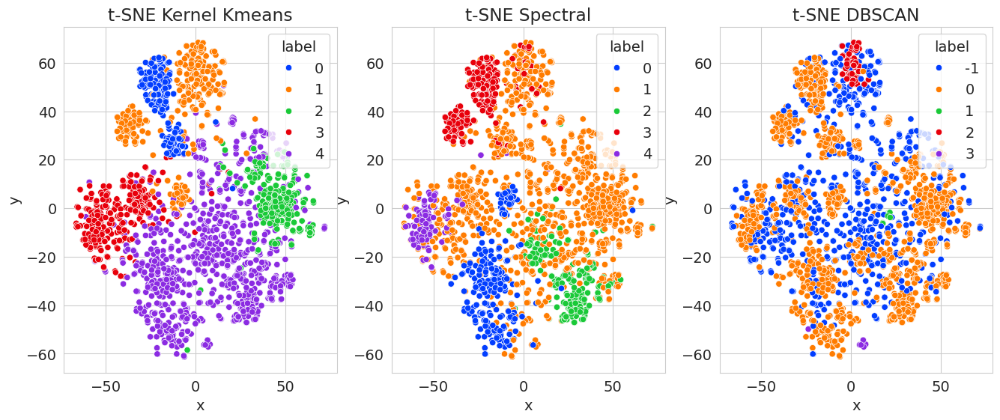

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(16, 6))
ax[0].set_title('t-SNE Kernel Kmeans')
ax[1].set_title('t-SNE Spectral')
ax[2].set_title('t-SNE DBSCAN')

df['label'] = kkmeans_labels
sns.scatterplot(x='x', y='y', hue='label', data=df, palette='bright', ax=ax[0])
df['label'] = spectral_labels
sns.scatterplot(x='x', y='y', hue='label', data=df, palette='bright', ax=ax[1])
df['label'] = dbscan_labels
sns.scatterplot(x='x', y='y', hue='label', data=df, palette='bright', ax=ax[2])

plt.show()

(?) Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Сделаете выводы о каждом исследованном в части 1 алгоритме и их применимости к задаче тематического моделирования. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:**

Видно, что первые два алгоритма - спектральный алгоритм и ядерный kmeans показывают себя достаточно хорошо на этих данных. Есть один кластер, который взял на себя большую часть объектов. Остальные кластеры не такие обширные, но тоже достаточно выделяющиеся. Это нельзя сказать про DBSCAN. Все данные достаточно плотно расположены в tsne представлении, однако обучение проходит в пространстве большой размерности, что делает этот плотностный алгоритм плохим для тематического моделирования текстов. Спектральный алгоритм нужно дополнительно настраивать, что усложняет его использование. А именно по tfidf представлению необходимо получить матрицу смежности по построенному графу на основе матрицы объекты-признаки. В kernel kmeans необходимо выбрать лишь ядро.



## Часть 2. Transfer learning для задачи классификации текстов.

**Задание 3.1 (4 балла).** Вспомним, что у нас есть разметка для тематик статей. Просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 1:13:6. 70% выборки будем использовать для обучения, а остальные 30% для валидации

Обучите метрику Махаланобиса любыми **тремя**  методами (отсюда)[http://contrib.scikit-learn.org/metric-learn/supervised.html] только на маленьком куске (5%) обучающей выборки. Кластеризуйте данные методом k-means с обученными метриками  и проанализирйте полученные результаты.

Сравните 3 подхода к класификации:

Логистическая регрессия на tf-idf признаках

K-Means с евклидовой метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

K-Means с обученной метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всей обучающей выборке целиком (70%), а итоговый классификатор и обучение метрики обучайте только на ее маленьком куске (5%). Подберите гиперпараметры моделей по качеству на валидационной выборке (30%), а затем оцените качество на тестовой выборке (не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации).

**В качестве метрики качества используйте accuracy**

Можете провести дополнительные исследования с другими методами кластеризации и получить более высокое качество. За качественные исследования с хорошим описанием можно получить **до 2 бонусных баллов**.

In [25]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer

df_minimum = 100

target = data['category'].copy()
new_data = data.drop(['filename', 'category'], axis=1)

tfidf = TfidfVectorizer(tokenizer=(lambda s: s), stop_words='english', lowercase=False, min_df=df_minimum)
tfidf.fit(new_data.text.tolist())
data_tfidf = tfidf.transform(data.text.tolist()).toarray()

/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:409: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['b', 'c', 'd', 'e', 'f', 'g', 'h', 'k', 'l', 'm', 'n', 'o', 'p', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y'] not in stop_words.
  warnings.warn(


In [26]:
from sklearn.preprocessing import LabelEncoder
target = LabelEncoder().fit_transform(target)

In [27]:
data_tfidf.shape

(2225, 617)

In [28]:
data_train, data_test, target_train, target_test = train_test_split(data_tfidf, target, train_size=0.8, shuffle=True, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(data_train, target_train, train_size=0.7, shuffle=True, random_state=42)

In [29]:
X_metrics = X_train[:int(X_train.shape[0] * 0.05)] # 5% for metrics training
y_metrics = y_train[:int(X_train.shape[0] * 0.05)] # 5% for metrics training

In [30]:
!pip install metric_learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 1.3 MB/s eta 0:00:00


In [31]:
from metric_learn import LMNN, NCA, MLKR
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
from sklearn.manifold import TSNE
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

nca = NCA(random_state=42)
mlkr = MLKR(random_state=42)
lmnn = LMNN(max_iter=100, random_state=42)

RCA не подошёл, так как в результате получаются NaN значения после преобразования выборки


NCA analysis


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


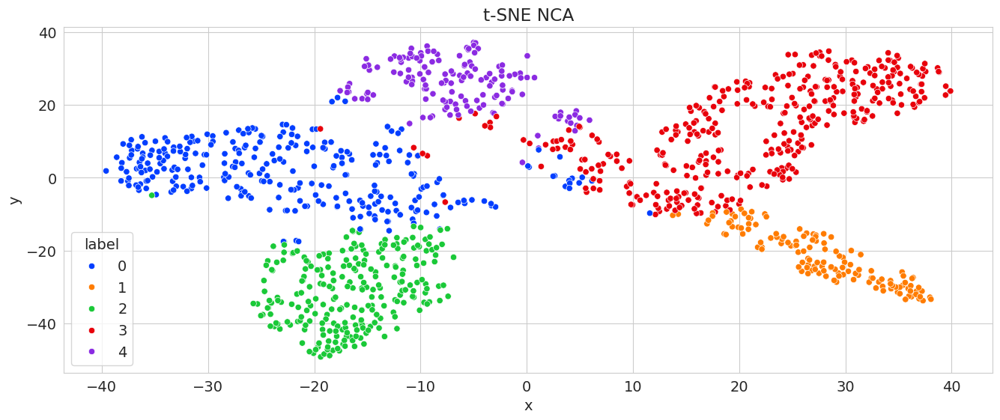

In [32]:
nca.fit(X_metrics, y_metrics)
kmeans = KMeans(n_clusters=5).fit(nca.transform(X_train))
labels = kmeans.labels_
X_embedded = TSNE().fit_transform(nca.transform(X_train))


df = pd.DataFrame(X_embedded, columns=['x', 'y'])
df['label'] = labels
fig, ax = plt.subplots(figsize=(16, 6))
ax.set_title('t-SNE NCA')
sns.scatterplot(x='x', y='y', hue='label', data=df, palette='bright', ax=ax)
plt.show()

LMNN analysis


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


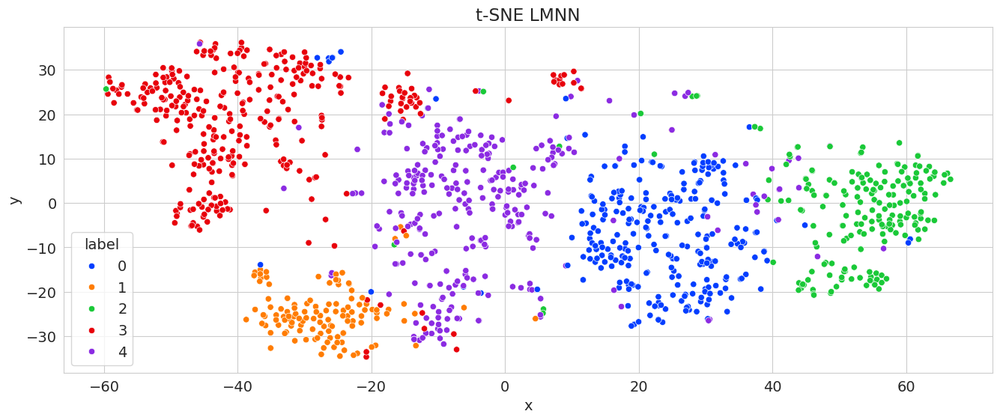

In [33]:
lmnn.fit(X_metrics, y_metrics)
kmeans = KMeans(n_clusters=5).fit(lmnn.transform(X_train))
labels = kmeans.labels_
X_embedded = TSNE().fit_transform(lmnn.transform(X_train))


df = pd.DataFrame(X_embedded, columns=['x', 'y'])
df['label'] = labels
fig, ax = plt.subplots(figsize=(16, 6))
ax.set_title('t-SNE LMNN')
sns.scatterplot(x='x', y='y', hue='label', data=df, palette='bright', ax=ax)
plt.show()

MLKR training


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


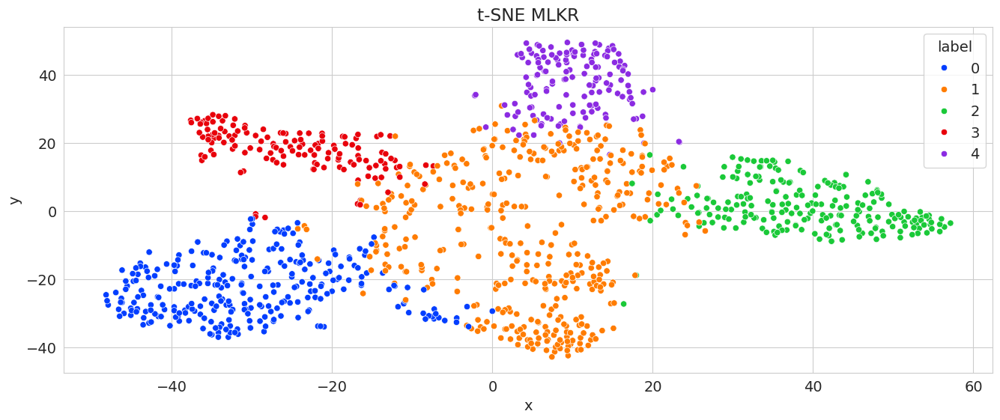

In [34]:
mlkr.fit(X_metrics, y_metrics)
kmeans = KMeans(n_clusters=5).fit(mlkr.transform(X_train))
labels = kmeans.labels_
X_embedded = TSNE().fit_transform(mlkr.transform(X_train))


df = pd.DataFrame(X_embedded, columns=['x', 'y'])
df['label'] = labels
fig, ax = plt.subplots(figsize=(16, 6))
ax.set_title('t-SNE MLKR')
sns.scatterplot(x='x', y='y', hue='label', data=df, palette='bright', ax=ax)
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


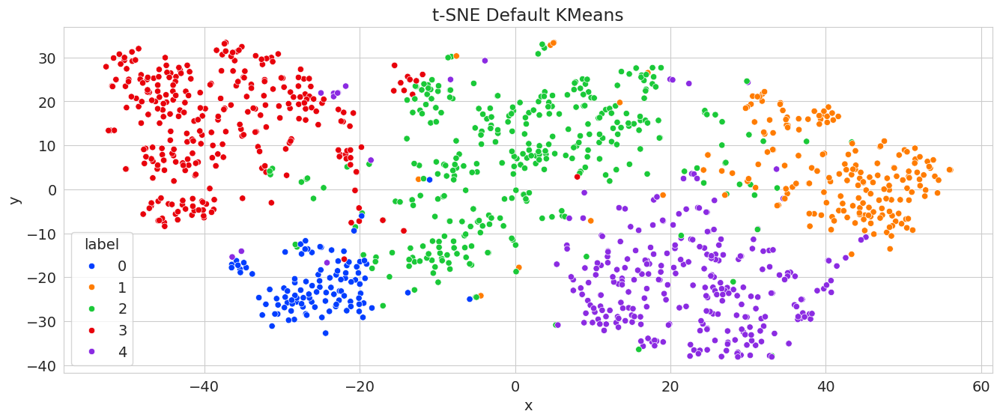

In [35]:
kmeans = KMeans(n_clusters=5).fit(X_train)
labels = kmeans.labels_
X_embedded = TSNE().fit_transform(X_train)


df = pd.DataFrame(X_embedded, columns=['x', 'y'])
df['label'] = labels
fig, ax = plt.subplots(figsize=(16, 6))
ax.set_title('t-SNE Default KMeans')
sns.scatterplot(x='x', y='y', hue='label', data=df, palette='bright', ax=ax)
plt.show()

**Логистическая регрессия**


In [36]:
from time import time
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

grid_search = GridSearchCV(estimator=LogisticRegression(max_iter=500),
                           param_grid={
                               'C': [0.001, 0.01, 0.1, 1, 10, 100],
                               'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']
                               },
                           n_jobs=-1,
                           cv=3,
                           scoring='accuracy'
                           )

start_time = time()

grid_search.fit(X_val, y_val)

print(f'Fitting time: {time() - start_time}')
print(f'Logistic Regression validation accuracy: {grid_search.best_score_}')
print(f'Logistic Regression Best paramss:', grid_search.best_params_)


lg_model = LogisticRegression(**grid_search.best_params_)
start_time = time()
lg_model.fit(X_metrics, y_metrics) # Fitting on 5%
preds = lg_model.predict(data_test)
print(f'LR time {time() - start_time}')
print(f'Test accuracy: {(preds == target_test).sum() / preds.shape[0]}') # Quality for test

Fitting time: 30.81247115135193
Logistic Regression validation accuracy: 0.9569288389513108
Logistic Regression Best paramss: {'C': 100, 'solver': 'liblinear'}
LR time 0.007950067520141602
Test accuracy: 0.8584269662921349


KMeans + евклидова метрика + лог. регрессия

In [37]:
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
import warnings

warnings.filterwarnings("ignore")

kmeans = KMeans(n_clusters=20)
kmeans.fit(X_train, y_train)
X_val_new = cdist(X_val, kmeans.cluster_centers_, metric='euclidean')
grid_search = GridSearchCV(estimator=LogisticRegression(max_iter=2000),
                           param_grid={
                               'C': [0.001, 0.01, 0.1, 1, 10, 100],
                               'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']
                               },
                           n_jobs=-1,
                           cv=3,
                           scoring='accuracy'
                           )

start_time = time()

grid_search.fit(X_val_new, y_val)

print(f'Fitting time: {time() - start_time}')
print(f'Logistic Regression validation accuracy: {grid_search.best_score_}')
print(f'Logistic Regression Best params:', grid_search.best_params_)

X_metrics_new = cdist(X_metrics, kmeans.cluster_centers_, metric='euclidean')

lg_model = LogisticRegression(**grid_search.best_params_)
start_time = time()
lg_model.fit(X_metrics_new, y_metrics) # Fitting on 5%


preds = lg_model.predict(cdist(data_test, kmeans.cluster_centers_, metric='euclidean'))
print(f'LR with kmeans time {time() - start_time}')
print(f'Test (kmeans) accuracy: {(preds == target_test).sum() / preds.shape[0]}') # Quality for test

Fitting time: 5.544309139251709
Logistic Regression validation accuracy: 0.9550561797752808
Logistic Regression Best params: {'C': 100, 'solver': 'sag'}
LR with kmeans time 0.0164031982421875
Test (kmeans) accuracy: 0.898876404494382


Kmeans + обученная метрика + лог. регрессия

NCA


In [38]:
X_train.shape

(1246, 617)

In [39]:
from sklearn.metrics.pairwise import euclidean_distances
from tqdm.notebook import tqdm

best_acc = 0.0
best_nc = -1
time_nca = -1

n_components = [80, 100, 500, X_metrics.shape[0], X_metrics.shape[1]]
n_clusters = 20

begin_time = time()

for n_component in tqdm(n_components):
    nca = NCA(n_components=n_component, random_state=42)
    nca.fit(X_metrics, y_metrics)

    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(nca.transform(X_train), y_train)

    X_val_new = euclidean_distances(nca.transform(X_val), kmeans.cluster_centers_)

    grid_search = GridSearchCV(estimator=LogisticRegression(max_iter=2000),
                               param_grid={
                                'C': [0.001, 0.01, 0.1, 1, 10, 100],
                                'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']
                                },
                               n_jobs=-1,
                               cv=3,
                               scoring='accuracy'
                               )

    grid_search.fit(X_val_new, y_val)

    X_metrics_new = euclidean_distances(nca.transform(X_metrics), kmeans.cluster_centers_)
    lg_model = LogisticRegression(**grid_search.best_params_)

    start_time = time()
    lg_model.fit(X_metrics_new, y_metrics) # Fitting on 5%

    preds = lg_model.predict(euclidean_distances(nca.transform(data_test), kmeans.cluster_centers_))
    accuracy = (preds == target_test).sum() / preds.shape[0]

    if accuracy > best_acc:
        best_acc = accuracy
        best_nc = n_component
        time_nca = time() - start_time

print(f'Best_accuracy: {best_acc}')
print(f'Best n_components: {best_nc}')
print(f'Time for training: {time_nca}')
print(f'Whole nca_time: {time() - begin_time}')

  0%|          | 0/5 [00:00<?, ?it/s]

Best_accuracy: 0.8426966292134831
Best n_components: 617
Time for training: 0.03505396842956543
Whole nca_time: 108.99625515937805


MLKR

In [40]:
from tqdm.notebook import tqdm

best_acc = 0.0
best_nc = X_metrics.shape[1]
time_nca = -1
best_cluster = -1

n_components = [X_metrics.shape[1]]
n_clusters = [5, 10, 25, 60, 100, 200]

begin_time = time()

for n_component in n_components:
    for n_cluster in tqdm(n_clusters):
        mlkr = MLKR(n_components=n_component, random_state=42)
        mlkr.fit(X_metrics, y_metrics)

        kmeans = KMeans(n_clusters=n_cluster)
        kmeans.fit(mlkr.transform(X_train), y_train)

        X_val_new = euclidean_distances(mlkr.transform(X_val), kmeans.cluster_centers_)

        grid_search = GridSearchCV(estimator=LogisticRegression(max_iter=2000),
                                param_grid={
                                    'C': [0.001, 0.01, 0.1, 1, 10, 100],
                                    'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']
                                    },
                                n_jobs=-1,
                                cv=3,
                                scoring='accuracy'
                                )

        grid_search.fit(X_val_new, y_val)

        X_metrics_new = euclidean_distances(mlkr.transform(X_metrics), kmeans.cluster_centers_)
        lg_model = LogisticRegression(**grid_search.best_params_)

        start_time = time()
        lg_model.fit(X_metrics_new, y_metrics) # Fitting on 5%

        preds = lg_model.predict(euclidean_distances(mlkr.transform(data_test), kmeans.cluster_centers_))
        accuracy = (preds == target_test).sum() / preds.shape[0]

        if accuracy > best_acc:
            best_acc = accuracy
            best_nc = n_component
            time_nca = time() - start_time
            best_cluster = n_cluster

print(f'Best_accuracy: {best_acc}\n')
print(f'Best n_components and n_clusters: {best_nc}, {best_cluster}')
print(f'Time for training: {time_nca}')
print(f'Whole nca_time: {time() - begin_time}')

  0%|          | 0/6 [00:00<?, ?it/s]

Best_accuracy: 0.7348314606741573

Best n_components and n_clusters: 617, 100
Time for training: 0.05412936210632324
Whole nca_time: 287.89835143089294


LMNN


In [41]:
from tqdm.notebook import tqdm

best_acc = 0.0
best_nc = X_metrics.shape[1]
time_nca = -1
best_cluster = -1
best_neighbor = -1

n_component = X_metrics.shape[1]

n_neighbors = [3, 5, 6]
n_clusters = [5, 10, 25]


begin_time = time()

for n_neighbor in tqdm(n_neighbors):
    for n_cluster in tqdm(n_clusters):
        lmnn = LMNN(n_neighbors=n_neighbor, n_components=n_component, random_state=42)
        lmnn.fit(X_metrics, y_metrics)

        kmeans = KMeans(n_clusters=n_cluster)
        kmeans.fit(lmnn.transform(X_train), y_train)

        X_val_new = euclidean_distances(lmnn.transform(X_val), kmeans.cluster_centers_)

        grid_search = GridSearchCV(estimator=LogisticRegression(max_iter=1000),
                                param_grid={
                                    'C': [0.1, 1, 10, 100],
                                    'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag']
                                    },
                                n_jobs=-1,
                                cv=3,
                                scoring='accuracy'
                                )

        grid_search.fit(X_val_new, y_val)

        X_metrics_new = euclidean_distances(lmnn.transform(X_metrics), kmeans.cluster_centers_)
        lg_model = LogisticRegression(**grid_search.best_params_)

        start_time = time()
        lg_model.fit(X_metrics_new, y_metrics) # Fitting on 5%

        preds = lg_model.predict(euclidean_distances(lmnn.transform(data_test), kmeans.cluster_centers_))
        accuracy = (preds == target_test).sum() / preds.shape[0]

        if accuracy > best_acc:
            best_acc = accuracy
            best_nc = n_component
            time_nca = time() - start_time
            best_cluster = n_cluster
            best_neighbor = n_neighbor

print(f'Best_accuracy: {best_acc}\n')
print(f'Best n_components, and n_clusters, and neighbors: {best_nc}, {best_cluster}, {best_neighbor}')
print(f'Time for training: {time_nca}')
print(f'Whole nca_time: {time() - begin_time}')

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Best_accuracy: 0.8943820224719101

Best n_components, and n_clusters, and neighbors: 617, 10, 3
Time for training: 0.015929698944091797
Whole nca_time: 1865.9884884357452


(?) Сделайте выводы о применимости методов кластеризации для улучшения качества классификации. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:**

**Обучение метрик**

Подход однозначно заслуживает внимания, так как результаты улучшаются и становятся более интерпретируемыми. Это логично, так как мы предоставляем возможность учитывать структуру данных и находить преобразование признакового пространства (в нашем случае - в расстоянии Махалонобиса) в то, где подсчёт стандартной метрики будет более осмысленным.

По результатам кластеризации с обученными метриками:

NCA показал себя лучше всего - 5 кластеров выделились идеально, что можно хорошо видеть в результате многомерного шкалирования методом t-SNE

LMNN в связке с кластеризацией обычным KMeans чуть лучше, чем просто KMeans, однако время обучения данной метрики слишком большое, в сравнении с другими методами.

MLKR - нечто среднее между NCA и LMNN. Неплохие результаты по t-SNE представлению

**Качество обучения**

Обычная логистическая регрессия работает, в целом, неплохо. Качество $0.858$ на тесте. В данной задаче и пришлось сильно уменьшить размер признакового пространства из-за долгого обучения LMNN. Если же рассмотреть больше данных, то методы с использованием обученных метрик начинают работать гораздо лучше.

Кластеризация с евклидовой метрикой и логистическая регрессия на расстояниях до центроидов даёт $0.898$ на тесте. Такой подход показывал себя лучше всего во всех экспериментах и очередных запусках обучения.

По последнему подходу с обученными метриками видно, что NCA выдаёт на тесте качество $0.842$, однако, как уже было сказано, при большем числе признаков качество выше и, следовательно, лучше простой логистической регрессии. MLKR показывает себя хуже всего. Вероятно, это связано с не очень подходящей выборкой + небольшой размер пространства гиперпараметров при подборе лучшей комбинации (вынужденное решение из-за долгого обучения). LMNN работал дольше всего, однако показал лучшее качество из всех подходов с обученными метриками: $0.894$.

**Вывод**

Полагаю, что подход через использование кластеризации методом Kernel KMeans с обученной метрикой (NCA) и дальнейшим применением логистической регрессии на расстоянии до центров кластеров должен показать себя лучше всего с точки зрения баланса времени и качества. Если необходимо высокое качество, то вместо NCA необходимо использовать LMNN, но это будет затратно по времени. Обучение метрик - очень полезная вещь.

Итоговый лучший результат для этих экспериментов: KMeans + евклидова метрика + логистическая регрессия на расстояниях до центров кластеров с качеством $0.898$ на тестовой выборке.
